# Visualizing Gradient Optimizers <a name='top'></a>

## This notebook shows how a series of gradient optimizers work and converge to a simple loss function, and how it can be used to train machine learning models. The function to be optimized is mean squared error on data generated from a linear function with gaussian noise.

### The contents are as follows

1. [Generating Data](#generatedata)
2. [Gradient Descent](#batch)
3. [Stochastic Gradient Descent (SGD)](#sgd)
4. [Minibatch Gradient Descent](#mini)
5. [Gradient Descent with Momentum](#momentum)
6. [Root Mean Squared Propagation (RMSProp)](#rmsprop)
7. [Adaptive Moment Estimation (Adam)](#adam)
8. [Plotting Optimizer Data](#plot)
9. [Summary of Results](#summary)


### At the end of the notebook there is a plot of the loss function as well as the iterations taken per optimizer at each epoch.

In [1]:
# Imports
%matplotlib notebook
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import cm
from mpl_toolkits.mplot3d.axes3d import Axes3D
import plotly
import plotly.graph_objects as go

print(np.version.version)
print(matplotlib.__version__)
print(plotly.__version__)

1.18.5
3.3.2
4.8.2


## Generating Data <a name="generatedata"></a>

Let's use a toy function to generate some simple data to showcase what a machine learning model can do. Our goal is a regression problem that will fit a line from data generated by a function with noise. The function will be linear so as to have an easier time visualizing both parameters of the model. More complex functions that require more parameters to learn would force us to take only subsets of the data, or require data reduction techniques.

In [2]:
# Defines the function from which data will be generated in the form y = mx+b. The solution to the gradient
# optimizers will be the values defined here. The default for this notebook is 2x+3.

def func(x):
    y = 2*x+3
    # y = x**2
    
    return y

In [3]:
# Generate a linear space in X for creating data

X = np.linspace(-5,5, num=51)
print(X)

[-5.  -4.8 -4.6 -4.4 -4.2 -4.  -3.8 -3.6 -3.4 -3.2 -3.  -2.8 -2.6 -2.4
 -2.2 -2.  -1.8 -1.6 -1.4 -1.2 -1.  -0.8 -0.6 -0.4 -0.2  0.   0.2  0.4
  0.6  0.8  1.   1.2  1.4  1.6  1.8  2.   2.2  2.4  2.6  2.8  3.   3.2
  3.4  3.6  3.8  4.   4.2  4.4  4.6  4.8  5. ]


In [4]:
# Using the linear space X to generate corresponding Y-data with additional gaussian noise. Increased noise
# can be added here.

Y = func(X)
Y_rand = Y + np.random.normal(0,4,size=(Y.shape))
print(Y)
print(Y_rand)

[-7.  -6.6 -6.2 -5.8 -5.4 -5.  -4.6 -4.2 -3.8 -3.4 -3.  -2.6 -2.2 -1.8
 -1.4 -1.  -0.6 -0.2  0.2  0.6  1.   1.4  1.8  2.2  2.6  3.   3.4  3.8
  4.2  4.6  5.   5.4  5.8  6.2  6.6  7.   7.4  7.8  8.2  8.6  9.   9.4
  9.8 10.2 10.6 11.  11.4 11.8 12.2 12.6 13. ]
[-7.76810242 -8.36455362 -1.91419072  0.69905162 -5.9971903  -9.6767124
 -7.71663336 -9.11810365  3.4255494  -4.49137714 -0.34952052 -1.55922346
 -7.41749809  1.94673979 -6.46480749 -3.37296478 -0.51172596 -1.49777376
 -1.28470084 -0.13906279  3.98171751  0.70812925  2.02468054 -3.50705671
 -8.45776316  9.10783177 15.28803995  1.77667211 11.22335577  5.04047078
  8.98960209  3.31245186  5.50311491 -2.67971551  6.58746118  8.00745183
  8.92099017  4.83173704  2.50740856 14.49933708  9.08054663 11.62799188
  6.34735823  2.69171914 11.3833017   3.74069055 10.08594846 13.62416065
  7.36976308  2.99680881 17.75962136]


<IPython.core.display.Javascript object>


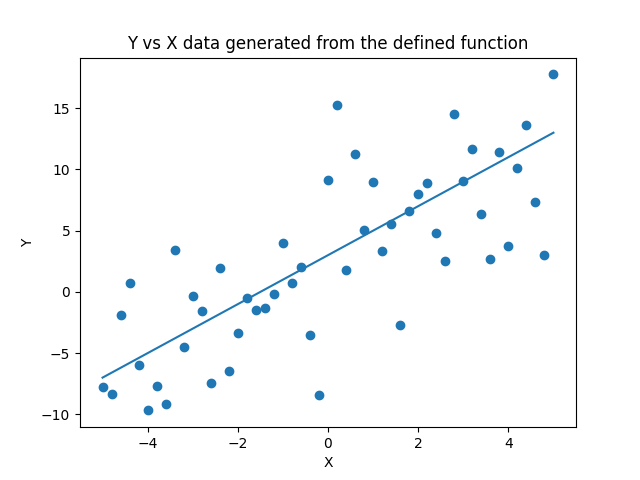

In [42]:
plt.figure()
plt.scatter(X, Y_rand)
plt.plot(X,Y)
plt.title('Y vs X data generated from the defined function')
plt.xlabel('X')
plt.ylabel('Y')
plt.show()

In [6]:
# Create Parameters

def initialize_params(seed=None, winit=-4, binit=-7):
    parameters = {}
    if seed:
        np.random.seed(seed)
        parameters["W"] =  4*np.random.randn()
        parameters["b"] =  4*np.random.randn()
    else:
        parameters["W"] = winit
        parameters["b"] = binit
    # print(parameters)
    return parameters

parameters = initialize_params()

# Generate surface map for loss using a mesh of W and b values.

W_linspace = np.linspace(-10,10,num=101)
b_linspace = np.linspace(-10,10,num=101)
predict_all = np.zeros((len(W_linspace), len(b_linspace), len(X)))
loss_all = np.zeros((len(W_linspace), len(b_linspace)))
W_mesh, b_mesh = np.meshgrid(W_linspace, b_linspace)

# Define forward prediction as wX+b
# Define loss as mean squared error 1/m*sum((y_hat-y)^2)
def predict(X, w, b):
    return w*X + b
def loss(pred, Y):
    return 1/len(Y)*np.sum(np.square(pred-Y))

# Ordering causes X:b, Y:W, Z:loss in plot
for i in range(len(W_linspace)):
    for j in range(len(b_linspace)):
        predict_all[i,j,:] = predict(X, W_linspace[i], b_linspace[j])
        # print(k, W_linspace[i], b_linspace[j])
        # print (loss(k, Y))
        loss_all[i,j] = loss(predict_all[i,j,:], Y)
        # print(W_linspace[i], b_linspace[j], loss_all[i,j])


# Y_pred = predict(X, parameters["W"], parameters["b"])
# print(Y_pred)

## Gradient Descent <a name="batch"></a>

This is an implementation of batch gradient descent. We update the parameters after a full pass through of the entire training data. As we use numpy arrays, we vectorize the functions so that we can perform the calculations in parallel. The update rule is as follows,

<center>
    $w = w - \alpha \frac{\partial L}{\partial w}$
    </center>
where $\alpha$ is a predetermined hyperparameter called the learning rate. We can define the error of the loss function attributed to the paramter w $\frac{\partial L}{\partial w}$ and simplify it to $dw$. The exact calculation of the this term is specified in the GradientDescent() function. This error term would be calculated differently if the model was changed (no longer wX+b) or if our loss function changed.

[Back to Top](#top)

In [7]:
# Defining Gradient Descent

def GradientDescent(X, Y, parameters):
    # We take the entire batch of m training samples and perform gradient descent on the parameters
    # For linear regression, the loss is...
        # L = 1/m sum(Y_hat - Y)^2
        # L = 1/m sum(Wx+b-Y)^2
        # dL/dW = 1/m sum[ 2*(Wx+b-Y)*W ]
        # dL/db = 1/m sum[ 2*(Wx+b-Y)*1 ]
        # Let Wx+b-Y = e , (e)rror term
        # dL/dW = 1/m sum(2*e*W)
        # dL/db = 1/m sum(2*e)
    
    W = parameters["W"]
    b = parameters["b"]
    grads = {}
    
    if type(Y) is not np.float64:
        m = len(Y)
    else:
        m = 1
            
        # Number of training examples
    
    # Normally, we'd use np.matmul(), however because this example is using scalar quantities 
    # (W is a single value)
    # We can proceed with using W*X
    y_hat = W*X+b
    error = W*X+b-Y
    loss = 1/m*np.sum(np.square(error))
    
    # Derivatives
    dL_dW = 1/m*np.sum(2*error*X)
    dL_db = 1/m*np.sum(2*error)
    
    grads["W"] = dL_dW
    grads["b"] = dL_db
    
    return loss, grads

def UpdateParams_GradientDescent(parameters, grads, learning_rate=1e-4):
    # Updates parameters W and b with Gradient Descent
    # If grads are calculated using all training examples then this is BatchGradientDescent
    # If grads are calculated using a SINGLE training example, then this is Stochastic Gradient Descent (SGD)
    
    W = parameters["W"]
    b = parameters["b"]
    
    dL_dW = grads["W"]
    dL_db = grads["b"]
    
    W = W - learning_rate*dL_dW
    b = b - learning_rate*dL_db
    
    parameters["W"] = W
    parameters["b"] = b
    
    return parameters
    

In [8]:
# Running one interation of GD...
parameters_GD = initialize_params(seed=1)
print("Initial Params: " + str(parameters_GD))
_, grads = GradientDescent(X, Y, parameters_GD)
parameters_GD = UpdateParams_GradientDescent(parameters_GD, grads)
print("Updated Params: " + str(parameters_GD))

Initial Params: {'W': 6.497381454652967, 'b': -2.4470256546003015}
Updated Params: {'W': 6.489585993464901, 'b': -2.4459362494693813}


In [9]:
def BatchGradientDescentAlgo(EPOCH=5, learning_rate=5e-2):
    # This function runs batch gradient descent for a predefined number of epochs at a set learning rate
    # This form allows us to iterate through epochs and generate multiple graphs easily at the end
    
    
    # print("Running Batch Gradient Descent")
    parameters_GD = initialize_params()
    # print("Initial Params: " + str(parameters_GD))

    epochs = []
    losses = []
    ws = []
    bs = []

    for e in range(EPOCH+1):
        W = parameters_GD["W"]
        b = parameters_GD["b"]
        ws.append(W)
        bs.append(b)
        loss_gd, grads = GradientDescent(X, Y, parameters_GD)
        losses.append(loss_gd)
        parameters_GD = UpdateParams_GradientDescent(parameters_GD, grads, learning_rate=learning_rate)
        epochs.append(e)
        
    return epochs, losses, ws, bs

epochs, losses, ws, bs = BatchGradientDescentAlgo()
print("Updated Params: " + str(parameters_GD))
plt.figure(3)
plt.plot(epochs, losses)
plt.title('Loss per epoch on Batch Gradient Descent')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.show()

Updated Params: {'W': 6.489585993464901, 'b': -2.4459362494693813}


<IPython.core.display.Javascript object>

## Stochastic Gradient Descent (SGD) <a name="sgd"></a>

    Let m = number of training examples

SGD uses the same update rules as regular gradient descent, however we take only a ***single*** training example and update based on our performance on it. This means we update **m-times PER epoch** for a total number of m\*epochs updates to our weights.

The concept here is that instead of having to go through every training example to update only once, we would have better performance if we update more frequently. Even though the direction we are going (the gradient) technically isn't the best (optimal calculated through all training examples), it's better that we take more steps towards the optimum.  

SGD converges much faster than batch gradient descent, and in this problem, converges the fastest out of all the optimizers. However this is likely due to the simplicty of the problem and the uniformity of the data distribution.

The downside with SGD is that we lose the computational performance benefits of vectorization because the algorithm takes single training examples. We also need to update our weights more frequently. Thus, SGD scales poorly with incredibly large networks with many parameters, as updating every parameter many times over could be costly time-wise.

[Back to Top](#top)

In [10]:
# Stochastic Gradient Descent

# We can perform SGD by performing GradientDescent() on a single training example...
def SGDAlgo(EPOCH=3, learning_rate=5e-2):
    # This function runs stochastic gradient descent for a set number of epochs at a set learning rate.
    # This implementation is fully random so we do not guarantee each training example be used the same
    # number of times.
    
    parameters_SGD = initialize_params()
    # print("Initial Params: " + str(parameters_SGD))

    epochs_SGD = []
    losses_SGD = []
    testlosses_SGD = []
    ws_SGD = []
    bs_SGD = []
    np.random.seed(2)
    
    for e in range(X.size*(EPOCH)+1): # The number of iterations is the size of the training set * num epochs
        W = parameters_SGD["W"]
        b = parameters_SGD["b"]
        ws_SGD.append(W)
        bs_SGD.append(b)
        test_loss_at_point = loss(predict(X, parameters_SGD["W"], parameters_SGD["b"]), Y)
        testlosses_SGD.append(test_loss_at_point)

        # Randomly sample a single training example
        which_index = np.random.randint(0, X.size)
        X_single = X[which_index]
        Y_single = Y[which_index]

        loss_sgd, grads = GradientDescent(X_single, Y_single, parameters_SGD)
        losses_SGD.append(loss_sgd)
        parameters_SGD = UpdateParams_GradientDescent(parameters_SGD, grads, learning_rate=learning_rate)

        epochs_SGD.append(e)
    return epochs_SGD, losses_SGD, ws_SGD, bs_SGD, parameters_SGD, testlosses_SGD


epochs_SGD, losses_SGD, ws_SGD, bs_SGD, parameters_SGD, testlosses_SGD = SGDAlgo()
print("Updated Params: " + str(parameters_SGD))
# print(len(losses_SGD), len(bs_SGD), len(ws_SGD), len(testlosses_SGD))
plt.figure(4)
plt.plot(epochs_SGD, losses_SGD)
plt.title('Loss v Updates for Stochastic Gradient Descent')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.show()

Updated Params: {'W': 2.000000017173059, 'b': 2.999999953801564}


<IPython.core.display.Javascript object>

## Minibatch Gradient Descent <a name="mini"></a>

Minibatch gradient descent is a midpoint between full batch gradient descent, and stochastic gradient descent. Minibatch GD divides the entire training set into batches of a predetermined size. Each chunk (batch) of the data is then trained on and the weights are updated accordingly. This means that more data is being used per iteration compared to SGD and there are less updates which makes this well suited for models with a large set of parameters. Using batches, we take a better step (closer to the true gradient) which means we converge in less updates.

If we take the batch size to be 1, then the algorithm is actually SGD. If we take the batch size to be the entire training set, m, then we have batch gradient descent.

[Back to Top](#top)

In [11]:
# Minibatch Gradient Descent

def MinibatchGradientDescentAlgo(EPOCH=3, learning_rate=5e-2, batch_size=4):
    # This function implements a minibatch gradient descent algorithm run at a determined number of epochs
    # a set learning rate, and a set batch size.
    # We randomly shuffle the data per epoch before splitting into the batches. Weights are updated per batch
    
    # print("Running Minibatch Gradient Descent")
    parameters = initialize_params()
    # print("Initial Params: " + str(parameters))

    epochs = []
    losses = []
    losses_test = []
    ws = []
    bs = []
    np.random.seed(1)
    
    m = Y.size
    
    # Get the number of full batches within the training set. Casting to int acts as a floor function.
    num_full_batches = int(m/batch_size)
    batch = 0
    # print(num_batches)
    
    itr = 0
    for e in range(EPOCH+1):
        mini_batches = []
        
        # Shuffle data keeping together the corresponding X-Y labels
        p = np.random.permutation(len(X))
        X_shuff = X[p]
        Y_shuff = Y[p]
        
        # Generate minibatches
        for k in range(num_full_batches):
            mini_batch_X = X_shuff[k*batch_size:(k+1)*batch_size]
            mini_batch_Y = Y_shuff[k*batch_size:(k+1)*batch_size]
            mini_batches.append((mini_batch_X, mini_batch_Y))
            
        if m % batch_size != 0:
            mini_batch_X = X_shuff[num_full_batches*batch_size:]
            mini_batch_Y = Y_shuff[num_full_batches*batch_size:]
            mini_batches.append((mini_batch_X, mini_batch_Y))

        # Update parameters per set of minibatches
        for minibatch in mini_batches:
            W = parameters["W"]
            b = parameters["b"]
            ws.append(W)
            bs.append(b)
            loss_test = loss(predict(X, W, b), Y)
            losses_test.append(loss_test)
            
            X_mini, Y_mini = minibatch
            
            loss_gd, grads = GradientDescent(X_mini, Y_mini, parameters)
            losses.append(loss_gd)
            parameters = UpdateParams_GradientDescent(parameters, grads, learning_rate=learning_rate)
            epochs.append(itr)
            itr += 1
        
    return epochs, losses, ws, bs, parameters, losses_test

epochs_mini, losses_mini, ws_mini, bs_mini, parameters_mini, testlosses_mini = MinibatchGradientDescentAlgo()
print("Updated Params: " + str(parameters_mini))
# print(len(losses_SGD))
plt.figure(5)
plt.plot(epochs_mini, losses_mini)
plt.title('Loss v Updates for Minibatch Gradient Descent')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.show()

Updated Params: {'W': 2.010255986234161, 'b': 2.9568070134089908}


<IPython.core.display.Javascript object>

## Gradient Descent with Momentum <a name="momentum"></a>

Momentum is most simply defined as an exponentional weighted moving average of the gradient. The mathematical formulation for momentum is
    <center>
    $v_{dw}^{t+1} = \beta v_{dw}^t + (1-\beta) dw$
    </center>
where $v_{dw}$ is the exponentially weighted average of the gradients $dw$, and $\beta$ is a hyperparameter that determines how many iteration steps are relevant based on the formulation $\frac{1}{1-\beta}$. This formulation is akin to the physical interpretation of a ball rolling down a hill and gaining speed. Thus a change in the gradient (going uphill after passing the middle) won't necessarily stop the ball immediately. The parameters are updated as follows,
    <center>
    $w = w - \alpha v_{dw}$
    </center>

The goal of momentum is to smoothen learning because gradients along some dimension that is constantly changing back and forth would average out to 0. Thus any optimum along that direction is reached quickly. Another benefit of momentum is that the optimization has the ability to kick itself out of local minima which is a trap basic gradient descent will fall into.

[Back to Top](#top)

In [12]:
# Momentum

def MinibatchWithMomentumAlgo(EPOCH=3, learning_rate=5e-2, beta_1 = 0.9, batch_size=4):
    # Momentum uses Vdw(t+1) = beta*Vdw(t) + (1-beta)*dw. Similarly for db.
    # This is an exponentially weighted moving average which smoothens updates
    
    # print("Running Minibatch Gradient Descent")
    parameters = initialize_params()
    # print("Initial Params: " + str(parameters))

    epochs = []
    losses = []
    losses_test = []
    ws = []
    bs = []
    np.random.seed(1)
    
    m = Y.size
    
    num_full_batches = int(m/batch_size)
    batch = 0
    # print(num_batches)
    
    itr = 0
    
    # initialize momentum constants
    vdw = 0
    vdb = 0
    
    
    for e in range(EPOCH+1):
        mini_batches = []
        
        # Shuffle Data
        p = np.random.permutation(len(X))
        X_shuff = X[p]
        Y_shuff = Y[p]
        
        for k in range(num_full_batches):
            mini_batch_X = X_shuff[k*batch_size:(k+1)*batch_size]
            mini_batch_Y = Y_shuff[k*batch_size:(k+1)*batch_size]
            mini_batches.append((mini_batch_X, mini_batch_Y))
            
        if m % batch_size != 0:
            mini_batch_X = X_shuff[num_full_batches*batch_size:]
            mini_batch_Y = Y_shuff[num_full_batches*batch_size:]
            mini_batches.append((mini_batch_X, mini_batch_Y))
        

        
        for minibatch in mini_batches:
            W = parameters["W"]
            b = parameters["b"]
            ws.append(W)
            bs.append(b)
            loss_test = loss(predict(X, W, b), Y)
            losses_test.append(loss_test)
            
            X_mini, Y_mini = minibatch
            
            loss_gd, grads = GradientDescent(X_mini, Y_mini, parameters)
            losses.append(loss_gd)
            
            # Implement momentum to update parameters
            vdw = beta_1*vdw + (1-beta_1)*grads["W"]
            vdb = beta_1*vdb + (1-beta_1)*grads["b"]
            
            parameters["W"] = parameters["W"] - learning_rate*vdw
            parameters["b"] = parameters["b"] - learning_rate*vdb
            
            # parameters = UpdateParams_GradientDescent(parameters, grads, learning_rate=learning_rate)
            epochs.append(itr)
            itr += 1
        
    return epochs, losses, ws, bs, parameters, losses_test

epochs_mini_mom, losses_mini_mom, ws_mini_mom, bs_mini_mom, parameters_mini_mom, testlosses_mini_mom = MinibatchWithMomentumAlgo()
print("Updated Params: " + str(parameters_mini_mom))
# print(len(losses_SGD))
plt.figure(6)
plt.plot(epochs_mini_mom, losses_mini_mom)
plt.title('Loss v Updates for Gradient Descent with Momentum')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.show()

Updated Params: {'W': 2.192408640005968, 'b': 2.836956237214934}


<IPython.core.display.Javascript object>

## RMS Prop <a name="rmsprop"></a>

RMS prop is an algorithm that is similar to gradient descent with momentum. Its purpose is to adapt the learning rate of each parameter individually based on a running average of the magnitudes of the weights for that parameter. In a similar formulation to momentum,
    <center>
    $s_{dw}^{t+1} = \beta s_{dw}^t + (1-\beta) dw^2$    
    </center>
It is important to note that the $\beta$ used here is a different hyperparameter used to update the moving average. Its function is the same as that in momentum, however the update rule has changed.
    <center>
    $w = w - \alpha \frac{dw}{\sqrt{s_{dw} + \epsilon}}$    
    </center>
$\epsilon$ in this case is a very small number (on the order of 1e-8) to ensure numerical stability. 

[Back to Top](#top)

In [13]:
# RMS Prop

def RMSPropAlgo(EPOCH=3, learning_rate=5e-2, beta_2 = 0.999, batch_size=4, epsilon=1e-8):
    # Momentum uses Vdw(t+1) = beta*Vdw(t) + (1-beta)*dw. Similarly for db.
    # This is an exponentially weighted moving average which smoothens updates
    
    # print("Running Minibatch Gradient Descent")
    parameters = initialize_params()
    # print("Initial Params: " + str(parameters))

    epochs = []
    losses = []
    losses_test = []
    ws = []
    bs = []
    np.random.seed(1)
    
    m = Y.size
    
    num_full_batches = int(m/batch_size)
    batch = 0
    # print(num_batches)
    
    itr = 0
    
    # initialize RMS constants
    sdw = 0
    sdb = 0
    
    
    for e in range(EPOCH+1):
        mini_batches = []
        
        # Shuffle Data
        p = np.random.permutation(len(X))
        X_shuff = X[p]
        Y_shuff = Y[p]
        
        for k in range(num_full_batches):
            mini_batch_X = X_shuff[k*batch_size:(k+1)*batch_size]
            mini_batch_Y = Y_shuff[k*batch_size:(k+1)*batch_size]
            mini_batches.append((mini_batch_X, mini_batch_Y))
            
        if m % batch_size != 0:
            mini_batch_X = X_shuff[num_full_batches*batch_size:]
            mini_batch_Y = Y_shuff[num_full_batches*batch_size:]
            mini_batches.append((mini_batch_X, mini_batch_Y))
        

        
        for minibatch in mini_batches:
            W = parameters["W"]
            b = parameters["b"]
            ws.append(W)
            bs.append(b)
            loss_test = loss(predict(X, W, b), Y)
            losses_test.append(loss_test)
            
            X_mini, Y_mini = minibatch
            
            loss_gd, grads = GradientDescent(X_mini, Y_mini, parameters)
            losses.append(loss_gd)
            
            dw = grads["W"]
            db = grads["b"]
            
            # Implement RMSProp to update parameters
            sdw = beta_2*sdw + (1-beta_2)*np.square(dw)
            sdb = beta_2*sdb + (1-beta_2)*np.square(db)
            
            parameters["W"] = parameters["W"] - learning_rate*dw/np.sqrt(sdw+epsilon)
            parameters["b"] = parameters["b"] - learning_rate*db/np.sqrt(sdb+epsilon)
            
            # parameters = UpdateParams_GradientDescent(parameters, grads, learning_rate=learning_rate)
            epochs.append(itr)
            itr += 1
        
    return epochs, losses, ws, bs, parameters, losses_test

epochs_mini_RMS, losses_mini_RMS, ws_mini_RMS, bs_mini_RMS, parameters_mini_RMS, testlosses_mini_RMS = RMSPropAlgo()
print("Updated Params: " + str(parameters_mini_RMS))
# print(len(losses_SGD))
plt.figure(7)
plt.plot(epochs_mini_RMS, losses_mini_RMS)
plt.title('Loss v Updates for RMS Prop')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.show()

Updated Params: {'W': 2.0061778335398865, 'b': 2.456492940952186}


<IPython.core.display.Javascript object>

## Adam <a name="adam"></a>

Adam, originating from adaptive moment estimation, combines both gradient descent with momentum as well as RMS prop. Adam takes both moving averages for $v_{dw}$ and $s_{dw}$ to generate adaptive learning rates for each parameter. Thus, both first and second moments of the gradients are used in the update rule.
    <center>
    $v_{dw}^{t+1} = \beta_1 v_{dw}^t + (1-\beta_1) dw$
    </center>
    <center>
    $s_{dw}^{t+1} = \beta_2 s_{dw}^t + (1-\beta_2) dw^2$    
    </center>
$\beta_1$ and $\beta_2$ are separate hyperparameters that control the weighting of the first and second moments of the gradients respectively. Adam also has a bias correction implemented to improve the performance during the first few iterations as both $v_{dw}$ and $s_{dw}$ are initialized to 0. This correction factor is,
    <center>
    $v_{dw}^{t+1} = \frac{v_{dw}^{t+1}}{1-\beta_1^{t+1}}$
    </center>    <center>
    $s_{dw}^{t+1} = \frac{s_{dw}^{t+1}}{1-\beta_2^{t+1}}$
    </center>
    
and the parameters are updated as follows,
    <center>
    $w = w - \alpha \frac{v_{dw}}{\sqrt{s_{dw} + \epsilon}}$    
    </center>

[Back to Top](#top)

In [14]:
# Putting it all together with ADAM

def AdamAlgo(EPOCH=3, learning_rate=5e-2, beta_1 = 0.9, beta_2 = 0.999, batch_size=4, epsilon=1e-8):
    # Momentum uses Vdw(t+1) = beta*Vdw(t) + (1-beta)*dw. Similarly for db.
    # This is an exponentially weighted moving average which smoothens updates
    
    # print("Running Minibatch Gradient Descent")
    parameters = initialize_params()
    # print("Initial Params: " + str(parameters))

    epochs = []
    losses = []
    losses_test = []
    ws = []
    bs = []
    np.random.seed(1)
    
    m = Y.size
    
    num_full_batches = int(m/batch_size)
    batch = 0
    # print(num_batches)
    
    itr = 0
    
    # initialize Adam constants
    vdw = 0
    vdb = 0
    sdw = 0
    sdb = 0
    
    
    for e in range(EPOCH+1):
        mini_batches = []
        
        # Shuffle Data
        p = np.random.permutation(len(X))
        X_shuff = X[p]
        Y_shuff = Y[p]
        
        for k in range(num_full_batches):
            mini_batch_X = X_shuff[k*batch_size:(k+1)*batch_size]
            mini_batch_Y = Y_shuff[k*batch_size:(k+1)*batch_size]
            mini_batches.append((mini_batch_X, mini_batch_Y))
            
        if m % batch_size != 0:
            mini_batch_X = X_shuff[num_full_batches*batch_size:]
            mini_batch_Y = Y_shuff[num_full_batches*batch_size:]
            mini_batches.append((mini_batch_X, mini_batch_Y))
        
        for minibatch in mini_batches:
            W = parameters["W"]
            b = parameters["b"]
            ws.append(W)
            bs.append(b)
            loss_test = loss(predict(X, W, b), Y)
            losses_test.append(loss_test)
            
            X_mini, Y_mini = minibatch
            
            loss_gd, grads = GradientDescent(X_mini, Y_mini, parameters)
            losses.append(loss_gd)
            
            dw = grads["W"]
            db = grads["b"]
            
            # Implement RMSProp to update parameters
            vdw = beta_1*vdw + (1-beta_1)*dw
            vdb = beta_1*vdb + (1-beta_1)*db
            sdw = beta_2*sdw + (1-beta_2)*np.square(dw)
            sdb = beta_2*sdb + (1-beta_2)*np.square(db)
            
            # Bias correction (UNUSED)
            vdw_corr = vdw/(1-beta_1**(itr+1))
            vdb_corr = vdb/(1-beta_1**(itr+1))
            sdw_corr = sdw/(1-beta_2**(itr+1))
            sdb_corr = sdb/(1-beta_2**(itr+1))

            # In the default implementaiton, bias correction is NOT USED
            # After testing, correction slows down training initially, so higher learning rates can be used to adjust
            # Bias correction is only relevant for the first few updates, and thus are possibly not worth computing
            parameters["W"] = parameters["W"] - learning_rate*vdw/(np.sqrt(sdw)+epsilon)
            parameters["b"] = parameters["b"] - learning_rate*vdb/(np.sqrt(sdb)+epsilon)
            
            # parameters = UpdateParams_GradientDescent(parameters, grads, learning_rate=learning_rate)
            epochs.append(itr)
            itr += 1
        
    return epochs, losses, ws, bs, parameters, losses_test

epochs_mini_adam, losses_mini_adam, ws_mini_adam, bs_mini_adam, parameters_mini_adam, testlosses_mini_adam = AdamAlgo()
print("Updated Params: " + str(parameters_mini_adam))
# print(len(losses_SGD))
plt.figure(8)
plt.plot(epochs_mini_adam, losses_mini_adam)
plt.title('Loss v Updates for Adam')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.show()

Updated Params: {'W': 2.353338742238262, 'b': 1.6231433701794862}


<IPython.core.display.Javascript object>

In [15]:
# Putting it all together...

def generate_OptimizerData(e, l_r):

    epochs, losses, ws, bs = BatchGradientDescentAlgo(EPOCH=e, learning_rate=l_r)
    epochs_SGD, losses_SGD, ws_SGD, bs_SGD, parameters_SGD, testlosses_SGD = SGDAlgo(EPOCH=e, learning_rate=l_r)
    epochs_mini, losses_mini, ws_mini, bs_mini, parameters_mini, testlosses_mini = MinibatchGradientDescentAlgo(EPOCH=e, learning_rate=l_r)
    epochs_mini_mom, losses_mini_mom, ws_mini_mom, bs_mini_mom, parameters_mini_mom, testlosses_mini_mom = MinibatchWithMomentumAlgo(EPOCH=e, learning_rate=l_r)
    epochs_mini_RMS, losses_mini_RMS, ws_mini_RMS, bs_mini_RMS, parameters_mini_RMS, testlosses_mini_RMS = RMSPropAlgo(EPOCH=e, learning_rate=l_r)
    epochs_mini_adam, losses_mini_adam, ws_mini_adam, bs_mini_adam, parameters_mini_adam, testlosses_mini_adam = AdamAlgo(EPOCH=e, learning_rate=l_r)
    """
    print("Batch GD Updated Params: " + str(parameters_GD))
    print("SGD Updated Params: " + str(parameters_SGD))
    print("Minibatch Updated Params: " + str(parameters_mini))
    print("Momentum Updated Params: " + str(parameters_mini_mom))
    print("RMS Updated Params: " + str(parameters_mini_RMS))
    print("Adam Updated Params: " + str(parameters_mini_adam))
    """
    optimizerdata = {"e":e,
                     "bs":bs,
                     "ws":ws,
                     "losses":losses,
                     "bs_SGD":bs_SGD,
                     "ws_SGD":ws_SGD,
                     "testlosses_SGD":testlosses_SGD,
                     "bs_mini":bs_mini,
                     "ws_mini":ws_mini,
                     "testlosses_mini":testlosses_mini,
                     "bs_mini_mom":bs_mini_mom,
                     "ws_mini_mom":ws_mini_mom,
                     "testlosses_mini_mom":testlosses_mini_mom,
                     "bs_mini_RMS":bs_mini_RMS,
                     "ws_mini_RMS":ws_mini_RMS,
                     "testlosses_mini_RMS":testlosses_mini_RMS,
                     "bs_mini_adam":bs_mini_adam,
                     "ws_mini_adam":ws_mini_adam,
                     "testlosses_mini_adam":testlosses_mini_adam
                    }
    
    return optimizerdata


In [16]:
def addOptDataToFigure(plotly_fig, optimizerdata):
    plotly_fig.add_trace(go.Scatter3d(visible=False, x=optimizerdata["bs"], y=optimizerdata["ws"], z=optimizerdata["losses"], marker=dict(color='red', size=2), name="Batch Gradient Descent"))
    plotly_fig.add_trace(go.Scatter3d(visible=False, x=optimizerdata["bs_SGD"], y=optimizerdata["ws_SGD"], z=optimizerdata["testlosses_SGD"], marker=dict(size=2, color='cyan'), name="SGD"))
    plotly_fig.add_trace(go.Scatter3d(visible=False, x=optimizerdata["bs_mini"], y=optimizerdata["ws_mini"], z=optimizerdata["testlosses_mini"], marker=dict(size=2, color='yellow'), name="MinibatchGD"))
    plotly_fig.add_trace(go.Scatter3d(visible=False, x=optimizerdata["bs_mini_mom"], y=optimizerdata["ws_mini_mom"], z=optimizerdata["testlosses_mini_mom"], marker=dict(size=2, color='magenta'), name="Momentum"))
    plotly_fig.add_trace(go.Scatter3d(visible=False, x=optimizerdata["bs_mini_RMS"], y=optimizerdata["ws_mini_RMS"], z=optimizerdata["testlosses_mini_RMS"], marker=dict(size=2, color='white'), name="RMSProp"))
    plotly_fig.add_trace(go.Scatter3d(visible=False, x=optimizerdata["bs_mini_adam"], y=optimizerdata["ws_mini_adam"], z=optimizerdata["testlosses_mini_adam"], marker=dict(size=2, color='orange'), name="Adam"))



In [22]:
def addPlottedDataToFigure(plotly_fig, optimizerdata, X):
    # print(optimizerdata["ws_SGD"])
    plotly_fig.add_trace(go.Scatter(visible=False, x=X, y=optimizerdata["ws"][-1]*X+optimizerdata["bs"][-1], mode='lines', line=dict(color='red'), name="Batch Gradient Descent"))
    plotly_fig.add_trace(go.Scatter(visible=False, x=X, y=optimizerdata["ws_SGD"][-1]*X+optimizerdata["bs_SGD"][-1], mode='lines', line=dict(color='cyan'), name="SGD"))
    plotly_fig.add_trace(go.Scatter(visible=False, x=X, y=optimizerdata["ws_mini"][-1]*X+optimizerdata["bs_mini"][-1], mode='lines', line=dict(color='yellow'), name="MinibatchGD"))
    plotly_fig.add_trace(go.Scatter(visible=False, x=X, y=optimizerdata["ws_mini_mom"][-1]*X+optimizerdata["bs_mini_mom"][-1], mode='lines', line=dict(color='magenta'), name="Momentum"))
    plotly_fig.add_trace(go.Scatter(visible=False, x=X, y=optimizerdata["ws_mini_RMS"][-1]*X+optimizerdata["bs_mini_RMS"][-1], mode='lines', line=dict(color='gray'), name="RMSProp"))
    plotly_fig.add_trace(go.Scatter(visible=False, x=X, y=optimizerdata["ws_mini_adam"][-1]*X+optimizerdata["bs_mini_adam"][-1], mode='lines', line=dict(color='orange'), name="Adam"))

    

# Main Script to Generate and Plot Optimizer Data <a name="plot"></a>

In [32]:
# Main script to generate all data for all optimizers at defined epochs and learning rates

EPOCH = 20
ALPHA = 1e-2

plotly_fig = go.Figure()

plotly_fig.add_trace(go.Surface(z=loss_all, x=W_mesh, y=b_mesh, colorscale='viridis', name='Loss'))


# Generate epoch data for every "epoch" step
for i in range(0, EPOCH+1):
    optimdata = generate_OptimizerData(i, ALPHA)
    # print(optimdata)
    addOptDataToFigure(plotly_fig, optimdata)
    addPlottedDataToFigure(plotly_fig_2, optimdata, X)
    
plotly_fig.data[0].visible=True
plotly_fig.data[7].visible=True
plotly_fig.data[8].visible=True
plotly_fig.data[9].visible=True
plotly_fig.data[10].visible=True
plotly_fig.data[11].visible=True
plotly_fig.data[12].visible=True

# Generate slider data
steps = []
for e in range(0, EPOCH+1):
    step = dict(
        method="update",
        args=[{'visible': [False]*len(plotly_fig.data)},
              {'title': "Gradient Optimizers on Epoch: " + str(e) + ' | alpha: '+ str(ALPHA)}],
    )
    step["args"][0]["visible"][0] = True
    step["args"][0]["visible"][e*6+1] = True
    step["args"][0]["visible"][e*6+2] = True
    step["args"][0]["visible"][e*6+3] = True
    step["args"][0]["visible"][e*6+4] = True
    step["args"][0]["visible"][e*6+5] = True
    step["args"][0]["visible"][e*6+6] = True
    steps.append(step)

sliders = [dict(
        active=1,
        currentvalue={"prefix":"Epoch: "},
        pad={"t":5},
        steps=steps
)]

plotly_fig.update_layout(width=800,
                         height=800, 
                         legend=dict(
                                yanchor="top",
                                y=0.99,
                                xanchor="left",
                                x=0.01),
                         sliders=sliders,
                         title='Gradient Optimizers at Epoch: 0 | alpha: ' + str(ALPHA),
                         scene=dict(xaxis=dict(title='b'), yaxis=dict(title='w'), zaxis=dict(title='loss'))
                        )


plotly_fig.show()

In [92]:
# alloptimizernames = ["", "_SGD", "_mini","_mini_mom", "_mini_RMS", "_mini_adam"]

# lastoptim = generate_OptimizerData(200, 3e-3)
# print(len(lastoptim))

# for opt in alloptimizernames:
#     print("Len bs" + opt + ": " + str(len(lastoptim["bs"+opt])), 
#           "Len ws" + opt + ": " + str(len(lastoptim["ws"+opt])))

# for i in range(len(lastoptim["bs"])):
#     if i%5==0:
#         print("i: " + str(i))
#         print(
#             str(lastoptim["bs"][i]),
#             str(lastoptim["bs_SGD"][i*(X.size)]),
#             str(lastoptim["bs_mini"][i*(X.size//4+1)]),
#             str(lastoptim["bs_mini_mom"][i*(X.size//4+1)]),
#             str(lastoptim["bs_mini_RMS"][i*(X.size//4+1)]),
#             str(lastoptim["bs_mini_adam"][i*(X.size//4+1)]),
#         )
#         print(
#             str(lastoptim["ws"][i]),
#             str(lastoptim["ws_SGD"][i*(X.size)]),
#             str(lastoptim["ws_mini"][i*(X.size//4+1)]),
#             str(lastoptim["ws_mini_mom"][i*(X.size//4+1)]),
#             str(lastoptim["ws_mini_RMS"][i*(X.size//4+1)]),
#             str(lastoptim["ws_mini_adam"][i*(X.size//4+1)]),
#         )
#         print("="*10)


In [91]:


EPOCH = 300
ALPHA = 1e-2
ALPHA_2 = 3e-2

lastoptim = generate_OptimizerData(EPOCH, ALPHA)

plotly_fig_2 = go.Figure() 
plotly_fig_2.add_trace(go.Scatter(x=X, y=Y_rand, mode='markers', marker=dict(size=10), name='Data'))
plotly_fig_2.add_trace(go.Scatter(x=X, y=Y, mode='lines', line=dict(dash='dash', width=2), name='Baseline'))


for i in range(0, len(lastoptim["bs"])):
    plotly_fig_2.add_trace(go.Scatter(visible=False, x=X, y=lastoptim["ws"][i]*X+lastoptim["bs"][i], mode='lines', line=dict(color='red'), name="Batch Gradient Descent"))
    plotly_fig_2.add_trace(go.Scatter(visible=False, x=X, y=lastoptim["ws_SGD"][i*X.size]*X+lastoptim["bs_SGD"][i*X.size], mode='lines', line=dict(color='cyan'), name="SGD"))
    plotly_fig_2.add_trace(go.Scatter(visible=False, x=X, y=lastoptim["ws_mini"][i*(X.size//4+1)]*X+lastoptim["bs_mini"][i*(X.size//4+1)], mode='lines', line=dict(color='yellow'), name="MinibatchGD"))
    plotly_fig_2.add_trace(go.Scatter(visible=False, x=X, y=lastoptim["ws_mini_mom"][i*(X.size//4+1)]*X+lastoptim["bs_mini_mom"][i*(X.size//4+1)], mode='lines', line=dict(color='magenta'), name="Momentum"))
    plotly_fig_2.add_trace(go.Scatter(visible=False, x=X, y=lastoptim["ws_mini_RMS"][i*(X.size//4+1)]*X+lastoptim["bs_mini_RMS"][i*(X.size//4+1)], mode='lines', line=dict(color='gray'), name="RMSProp"))
    plotly_fig_2.add_trace(go.Scatter(visible=False, x=X, y=lastoptim["ws_mini_adam"][i*(X.size//4+1)]*X+lastoptim["bs_mini_adam"][i*(X.size//4+1)], mode='lines', line=dict(color='orange'), name="Adam"))



plotly_fig_2.data[0].visible=True
plotly_fig_2.data[1].visible=True
plotly_fig_2.data[8].visible=True
plotly_fig_2.data[9].visible=True
plotly_fig_2.data[10].visible=True
plotly_fig_2.data[11].visible=True
plotly_fig_2.data[12].visible=True
plotly_fig_2.data[13].visible=True

# Generate slider data
steps_2 = []
for e in range(0, EPOCH+1, 1):
    step = dict(
        method="update",
        args=[{'visible': [False]*len(plotly_fig_2.data)},
              {'title': "Gradient Optimizers on Epoch: " + str(e) + ' | alpha: '+ str(ALPHA)}],
    )
    step["args"][0]["visible"][0] = True
    step["args"][0]["visible"][1] = True
    step["args"][0]["visible"][e*6+2] = True
    step["args"][0]["visible"][e*6+3] = True
    step["args"][0]["visible"][e*6+4] = True
    step["args"][0]["visible"][e*6+5] = True
    step["args"][0]["visible"][e*6+6] = True
    step["args"][0]["visible"][e*6+7] = True
    steps_2.append(step)

sliders_2 = [dict(
        active=2,
        currentvalue={"prefix":"Epoch: "},
        pad={"t":5},
        steps=steps_2
)]

plotly_fig_2.update_layout(width=800,
                         height=800, 
                         legend=dict(
                                yanchor="top",
                                y=0.99,
                                xanchor="left",
                                x=0.01),
                         sliders=sliders_2,
                         title='Gradient Optimizers at Epoch: 0 | alpha: ' + str(ALPHA),
                         scene=dict(xaxis=dict(title='X'), yaxis=dict(title='Y'))
                        )
plotly_fig_2.update_xaxes(range=[-5, 5])
plotly_fig_2.update_yaxes(range=[-20, 20])

plotly_fig_2.show()

bs ws
bs_SGD ws_SGD
bs_mini ws_mini
bs_mini_mom ws_mini_mom
bs_mini_RMS ws_mini_RMS
bs_mini_adam ws_mini_adam


<IPython.core.display.Javascript object>


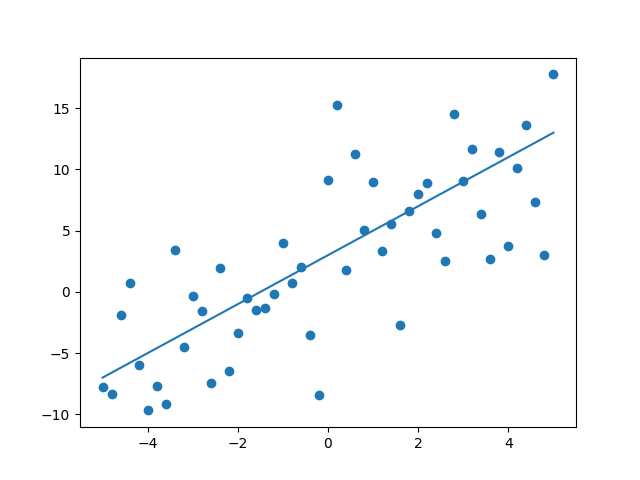

NameError: name 'w_adam' is not defined

In [19]:
def optimfunc(w, b, X):
    return w*X+b

alloptimizers = ["", "_SGD", "_mini","_mini_mom", "_mini_RMS", "_mini_adam"]

for opt in alloptimizers:
    print("bs"+opt, "ws"+opt)

plt.figure(9)
plt.scatter(X, Y_rand)
plt.plot(X,Y)
plt.plot(X, optimfunc(w_adam, b_adam, X))
plt.title('Y vs X data generated from the defined function')
plt.xlabel('X')
plt.ylabel('Y')
plt.show()
print(X)

# Summary of Results  <a name="summary"></a>
Using the graph above, we can analyze each of the curves separately.

### 1. Gradient Descent
Gradient descent steps in the most optimal direction each update. However, due to its low iteration number, it converges on the optimum very slowly. We would need more epochs before batch gradient descent reached our desired optimum!
### 2. SGD
SGD has the most erratic performance in that the direction of each step is far more randomly distributed. However, due to the simplicity of the function and the high number of iterations, SGD converges the quickest out of all the optimizers. This is not likely to be the case for complex functions and large scaled models with many trainable parameters. However, this graph shows the benefits of SGD as well as the downsides in stability.
### 3. Minibatch Gradient Descent
Minibatch GD is, as expected, a medium between batch GD and SGD. We see both a smoother movement towards the optimum, but with many more steps compared to batch gradient descent. Changing the batch size would bring the convergence closer to the respsective extreme versions of gradient descent.
### 4. Gradient Descent with Momentum
Momentum causes the optimizer to follow a path very similar to what a ball on a hill might experience. Due to the momentum, we can see the optimizer overshoot the minimum and have to follow an arc to return. Although the behavior is not as well suited in this situation, this same behavior is what allows for momentum to not be trapped in local minima, a feature that is much more useful when training on complex data and using larger models.
### 5. RMS Prop
RMS prop follows a much more direct path towards the optimum due to the adaptive learning of the parameters. Both parameters are updated at a rate on a similar order of magnitude. However, it encounters small oscillations and deviations from that direction. However due to the effectiveness of this learning, RMSprop is a powerful optimizer.
### 6. Adam
Adam combines both momentum and RMS prop. The first gradient moment (momentum) ensures the smoothness during each iteration. Adam is one of the smoothest curves by far. This means that training is very stable as it proceeds towards the optimum. Thanks to the adaptive learning from the second gradient moment, Adam also follows a very efficient direct path towards the optimum. Neither parameter is significantly favored and the optimizer quickly converges to the optimum. Although technically slower than SGD in terms of number of iterations, the stability coupled with the effectiveness of optimizing both parameters makes it sensible that Adam is a default choice optimizer for many ML applications.

[Back to top](#top)